<a href="https://colab.research.google.com/github/LongNguyen1984/TimeSeriesWithPython/blob/main/ConvertDFtoCSV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [137]:
import pandas as pd
from pandas import read_csv, DataFrame
import numpy as np

df2 = read_csv('ppgSen01.csv', header = 0)
# get the name columns
names = np.array(df2.columns[0:4])
df = df2[names]


In [143]:
df2.head(100)


,timestamp,850nm,635nm,940nm,525nm
0,2021-11-15T00:00:00Z,855923.0,-999999.0,944163.0,-1389970.0
1,2021-11-15T00:00:01Z,854478.0,-999795.0,945157.0,-1389850.0
2,2021-11-15T00:00:02Z,854314.0,-999665.0,944489.0,-1389500.0
3,2021-11-15T00:00:03Z,854482.0,-999618.0,944667.0,-1388830.0
4,2021-11-15T00:00:04Z,855532.0,-999612.0,945001.0,-1388760.0
...,...,...,...,...,...
95,2021-11-15T00:01:35Z,845422.0,-1000880.0,939112.0,-1389870.0
96,2021-11-15T00:01:36Z,845862.0,-1000880.0,937362.0,-1389990.0
97,2021-11-15T00:01:37Z,845256.0,-1001550.0,936673.0,-1390350.0
98,2021-11-15T00:01:38Z,844650.0,-1001410.0,935294.0,-1390290.0


In [5]:
import seaborn as sns

col_dict = {1:'#7bc90c',
            -1:'#ffb700',
            3:'#f5072f',
            4:'#d109e3',
            5: "#009dff",
            6: "#10ccb6",
            0: "#6484f5",
            8: "#ab0e3a",
            9: "#bd9e15",
            7: 'grey',
           }

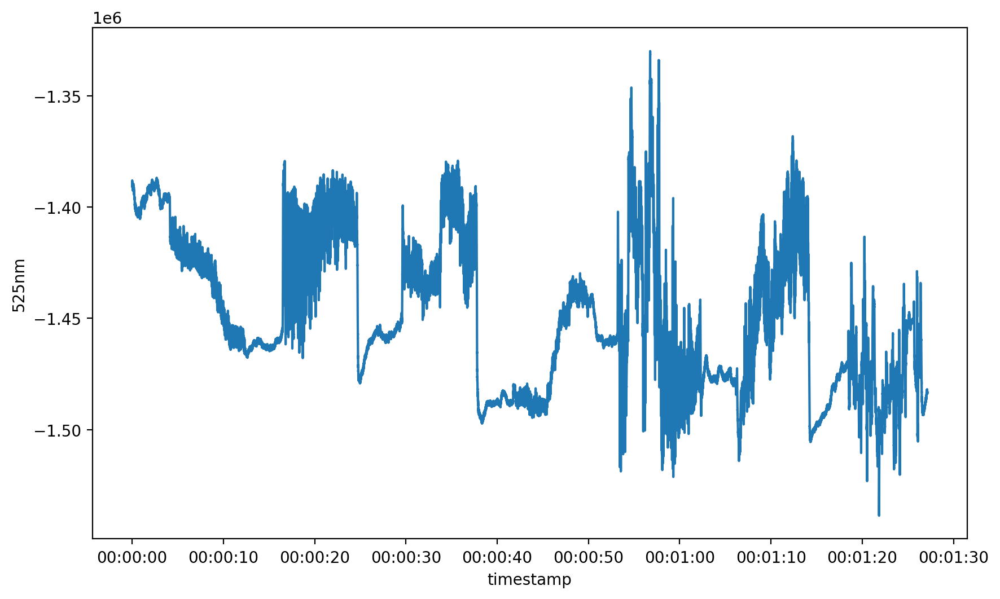

In [45]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6), dpi = 200)

sns.lineplot(x= df2['timestamp'], y= df2['525nm'])

### Adding a timestamp

In [139]:
df2.insert(0,'timestamp',pd.date_range("2021-11-15", freq="s", periods=df2.shape[0]))

In [140]:
df2['timestamp']= df2['timestamp'].apply(
        lambda x: x.strftime('%Y-%m-%dT%H:%M:%SZ'))

In [142]:
df2['timestamp'][10000:10010]

10000    2021-11-15T02:46:40Z
10001    2021-11-15T02:46:41Z
10002    2021-11-15T02:46:42Z
10003    2021-11-15T02:46:43Z
10004    2021-11-15T02:46:44Z
10005    2021-11-15T02:46:45Z
10006    2021-11-15T02:46:46Z
10007    2021-11-15T02:46:47Z
10008    2021-11-15T02:46:48Z
10009    2021-11-15T02:46:49Z
Name: timestamp, dtype: object

### Join in a single one

In [141]:
import numpy as np

header = list(df2.columns.values)
header = header[1:]

N = df2.shape[0]
series = [header[i%4] for i in range(0, 4*N)]
timestamp = [ df2.timestamp[(i//4)%N] for i in range(0, 4*N)]
value = [list(df2.iloc[i][1:]) for i in range(0, N)]
# flatten the values
value = np.concatenate(value).tolist() 

In [136]:
5//4

1

In [144]:
li = np.transpose([series, timestamp, value])
df = pd.DataFrame(data = li, columns=['series', 'timestamp','value'])



In [145]:
df['label'] = ''
df.to_csv("data2.csv", index = False)
#df = df.reset_index(drop=True)
print(df.head())

  series             timestamp       value label
0  850nm  2021-11-15T00:00:00Z    855923.0      
1  635nm  2021-11-15T00:00:00Z   -999999.0      
2  940nm  2021-11-15T00:00:00Z    944163.0      
3  525nm  2021-11-15T00:00:00Z  -1389970.0      
4  850nm  2021-11-15T00:00:01Z    854478.0      


In [133]:
df.head(20)

,series,timestamp,value,label
0,850nm,2021-11-15T00:00:00Z,855923.0,
1,635nm,2021-11-15T00:00:01Z,-999999.0,
2,940nm,2021-11-15T00:00:02Z,944163.0,
3,525nm,2021-11-15T00:00:03Z,-1389970.0,
4,850nm,2021-11-15T00:00:04Z,854478.0,
5,635nm,2021-11-15T00:00:05Z,-999795.0,
6,940nm,2021-11-15T00:00:06Z,945157.0,
7,525nm,2021-11-15T00:00:07Z,-1389850.0,
8,850nm,2021-11-15T00:00:08Z,854314.0,
9,635nm,2021-11-15T00:00:09Z,-999665.0,


### Save dataframe as a csv file

In [123]:
df.to_csv('ppgSample01.csv') 

In [135]:
import plotly.express as px
df = df2
df['id'] = [x/250 for x in range(1, len(df.values)+1)]
#df.index.name = 'id'
df.head()



,timestamp,850nm,635nm,940nm,525nm,id
0,2021-11-15T00:00:00Z,855923.0,-999999.0,944163.0,-1389970.0,0.004
1,2021-11-15T00:00:01Z,854478.0,-999795.0,945157.0,-1389850.0,0.008
2,2021-11-15T00:00:02Z,854314.0,-999665.0,944489.0,-1389500.0,0.012
3,2021-11-15T00:00:03Z,854482.0,-999618.0,944667.0,-1388830.0,0.016
4,2021-11-15T00:00:04Z,855532.0,-999612.0,945001.0,-1388760.0,0.020


### Resampling data from 250 to 70

In [ ]:
from scipy import signal

old_fs = 250
new_fs = 70
N = len(df)//old_fs*new_fs
df_rsp = signal.resample(df, N)
df_rsp =pd.DataFrame(df_rsp[:,:-1], columns=['630nm', '940nm','530nm','amb'])
df_rsp['id'] = [x/70 for x in range(1, len(df_rsp.values)+1)]

In [ ]:
old_fs1 = 70
new_fs1 = 1
N1 = len(df1)//old_fs1*new_fs1
df_rsp1 = signal.resample(df1, N1)
df_rsp1 =pd.DataFrame(df_rsp1, columns=['850nm', '630nm','940nm','525nm'])
df_rsp1['id'] = [x for x in range(1, len(df_rsp1.values)+1)]

In [ ]:
df_rsp1.head()

,850nm,630nm,940nm,525nm,id
0,335278.275566,-1.445237e+06,749761.959907,-1.615743e+06,1
1,142145.051694,-1.486915e+06,673458.282137,-1.628095e+06,2
2,186497.383846,-1.476374e+06,687328.232380,-1.625698e+06,3
3,160033.079918,-1.483060e+06,679410.212492,-1.627002e+06,4
4,179371.510325,-1.478072e+06,684769.385972,-1.626280e+06,5


In [ ]:
import plotly.express as px
import pandas as pd

df_rsp =pd.DataFrame(df[:,:-1], columns=['630nm', '940nm','530nm','amb'])
fig = px.line(df_rsp, x="id", y='630nm') 
fig.show()



In [ ]:
import plotly.graph_objects as go
fig = go.Figure()
signals = [x for x in df.columns.values if x != 'Time' and x != 'id']
for sig in signals:
  fig.add_trace(go.Scatter(x=df['id'], y=df[sig],
                    mode='lines',
                    name=sig))


fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1800, height=800)
fig.update_layout(title='PPG left data',
                   xaxis_title='Time',
                   yaxis_title='Amplitude')

In [ ]:
import pandas as pd

#path = 'drive/Shareddrives/AIOT_LAB_DOCS/Data/MAData/'

#df = pd.read_csv(path +'PPGthumb1.csv', header = 0)
df1['id'] = [x/70 for x in range(1, len(df1.values)+1)]
#df.index.name = 'id'
df1.head()


,850nm,635nm,940nm,525nm,id
0,1356440.0,-853254.0,974923.0,-1432860.0,0.014286
1,1357390.0,-853158.0,975467.0,-1431790.0,0.028571
2,1356810.0,-853023.0,975480.0,-1432500.0,0.042857
3,1357490.0,-852829.0,975723.0,-1431640.0,0.057143
4,1357690.0,-852583.0,976371.0,-1432050.0,0.071429


In [ ]:
import pandas as pd

#path = 'drive/Shareddrives/AIOT_LAB_DOCS/Data/MAData/'

#df = pd.read_csv(path +'PPGthumb1.csv', header = 0)
df3['id'] = [x/50 for x in range(1, len(df3.values)+1)]
#df.index.name = 'id'
df3.head()

,Acc_X,Acc_Y,Acc_Z,Acc_X2,Acc_Y2,Acc_Z2,id
0,0.02,0.09,-0.03,-0.02,0.02,-0.06,0.02
1,0.01,0.06,-0.04,-0.02,0.05,-0.06,0.04
2,0.01,0.10,-0.02,0.01,0.04,-0.04,0.06
3,0.05,0.04,0.00,0.00,-0.02,-0.03,0.08
4,0.05,0.05,0.00,0.01,0.01,0.00,0.10


In [ ]:
import plotly.graph_objects as go

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=df1['id'], y=df1['850nm'],
                    mode='lines',
                    name='850nm'))
fig.add_trace(go.Scatter(x=df1['id'], y=df1['635nm'],
                    mode='lines',
                    name='630nm'))

fig.add_trace(go.Scatter(x=df1['id'], y=df1['940nm'],
                    mode='lines',
                    name='940nm'))

fig.add_trace(go.Scatter(x=df1['id'], y=df1['525nm'],
                    mode='lines',
                    name='525'))

fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='PPG data',
                   xaxis_title='Samples',
                   yaxis_title='Amplitude')
#fig.add_trace(go.Scatter(x=random_x, y=random_y1, mode='lines+markers', name='lines+markers'))
#fig.add_trace(go.Scatter(x=random_x, y=random_y2, mode='markers', name='markers'))
fig.show()

In [ ]:
import plotly.graph_objects as go

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_X'],
                    mode='lines',
                    name='Acc_X'))
fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_Y'],
                    mode='lines',
                    name='Acc_Y'))

fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_Z'],
                    mode='lines',
                    name='Acc_Z'))


fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='ACC data',
                   xaxis_title='Samples',
                   yaxis_title='Amplitude')
#fig.add_trace(go.Scatter(x=random_x, y=random_y1, mode='lines+markers', name='lines+markers'))
#fig.add_trace(go.Scatter(x=random_x, y=random_y2, mode='markers', name='markers'))
fig.show()

In [ ]:
### Using Plotly
from matplotlib.ticker import AutoMinorLocator
from plotly.subplots import make_subplots
import plotly.graph_objs as go
from scipy import signal
# Create figure with secondary y-axis
#fig = make_subplots(rows=2, cols=1, insets=[{'l':0.1,'b':0.1, 'h':0.1}])
fig = make_subplots(rows=2, 
                    cols=1, 
                    specs=[
        [{}],
        [{}]],
                    
        shared_xaxes=True,
        #subplot_titles=("test1", "test2"),
        vertical_spacing=0.01)


#minTickLoc = np.linspace(0,120,5)

#fig = go.Figure()

fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_X'],
                    mode='lines',
                    name='Acc_X'), row = 1, col=1)
fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_Y'],
                    mode='lines',
                    name='Acc_Y'), row = 1, col=1)

fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_Z'],
                    mode='lines',
                    name='Acc_Z'), row = 1, col=1)


# fig.add_trace(go.Scatter(x=df1['id'], y=df1['850nm'],
#                     mode='lines',
#                     name='850nm'),
#               row = 1, col=1)

fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_X2'],
                    mode='lines',
                    name='Acc_X2'), row = 2, col=1)
fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_Y2'],
                    mode='lines',
                    name='Acc_Y2'), row = 2, col=1)

fig.add_trace(go.Scatter(x=df3['id'], y=df3['Acc_Z2'],
                    mode='lines',
                    name='Acc_Z2'), row = 2, col=1)

#fig.update_xaxes(title_text="Time (s)", row = 1, col = 1)
#fig.update_yaxes(title_text="Amplitude (hz)", row = 2, col = 1)
# fig.update_layout(
#     yaxis_title = 'Amplitude'
#     )
fig.update_yaxes(title_text="Amplitude Acc-1", row = 1, col = 1)
fig.update_yaxes(title_text="Amplitude Acc-2", row = 2, col = 1)
fig.update_xaxes(title_text="Time (s)", row = 2, col = 1)
fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1800, height=800)
fig.update_layout(title_text="Acc Signals")

### Save the figure as a HTML file
# with open('Spectrogram'+'.html', 'a') as f:
#   f.write(fig.to_html(full_html=False, include_plotlyjs='cdn'))

In [ ]:
#df1.columns.values[0]
fig = go.Figure()
signals = [x for x in df1.columns.values if x != 'Time' and x != 'id']
for sig in signals:
  fig.add_trace(go.Scatter(x=df1['id'], y=df1[sig],
                    mode='lines',
                    name=sig))


fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='PPG left data',
                   xaxis_title='Time',
                   yaxis_title='Amplitude')

### Display FFT

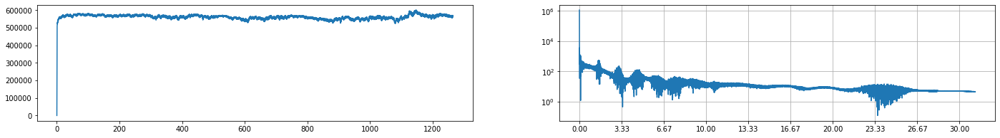

In [ ]:
from scipy import pi
import matplotlib.pyplot as plt
from scipy.fftpack import fft,fftfreq
# Number of sample points
N = np.shape(df)[0]
fs = 250
# sample spacing
T = 1.0 /fs
#y = df['Ch : LED 2'].values

x = np.linspace(0.0, N*T, N, endpoint=False)
y = df['Ch : LED 2'].values
yf = fft(y)
xf = fftfreq(N, T)[:N//2]

plt.figure(figsize=(24,3))

plt.subplot(1,2,1)
plt.plot (x,y)

plt.subplot(1,2,2)
L1, L2 = 0, 30
plt.plot(xf[:N//8], 2.0/N * np.abs(yf[:N//8]))
plt.xticks(np.linspace(L1, L2, 10) )
plt.yscale('log')
plt.grid()

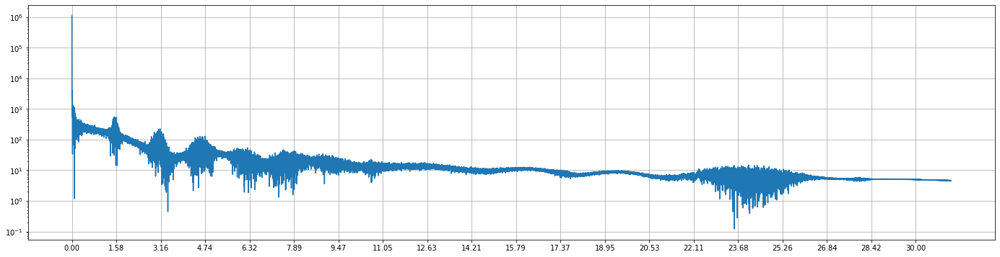

In [ ]:
plt.figure(figsize=(24,6))
L1, L2 = 0, 30
plt.plot(xf[:N//8], 2.0/N * np.abs(yf[:N//8]))
plt.xticks( np.linspace(L1, L2, 20) )
plt.yscale('log')
plt.grid()

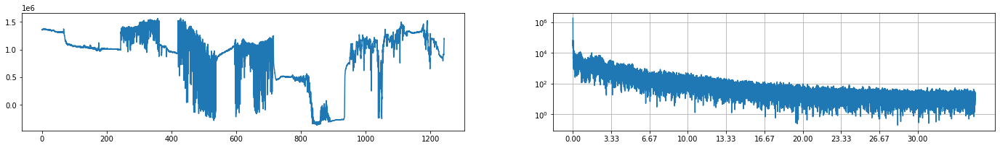

In [ ]:
N1 = np.shape(df1)[0]
fs1 = 70
# sample spacing
T1 = 1.0 /fs1
#y = df['Ch : LED 2'].values

x1 = np.linspace(0.0, N1*T1, N1, endpoint=False)
y1 = df1['850nm'].values
yf1 = fft(y1)
xf1 = fftfreq(N1, T1)[:N1//2]

plt.figure(figsize=(24,3))

plt.subplot(1,2,1)
plt.plot (x1,y1)

plt.subplot(1,2,2)
L1, L2 = 0, 30
plt.plot(xf1[:N1//2], 2.0/N1 * np.abs(yf1[:N1//2]))
plt.xticks(np.linspace(L1, L2, 10) )
plt.yscale('log')
plt.grid()

In [ ]:
import plotly.graph_objects as go
#from plotly.subplots import make_subplots
#fig = make_subplots(rows=1, cols=2, subplot_titles=("Default Scale", "Logarithmic Scale"))
plt.figure(figsize=(24,6))
L1,L2=0,35000
# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=xf[L1:L2], y=2.0/N * np.abs(yf[L1:L2]),
                    mode='lines',
                    name='850nm'))

fig.add_trace(go.Scatter(x=xf1[L1:L2], y=2.0/N1 * np.abs(yf1[L1:L2]),
                    mode='lines',
                    name='850nm'))
#fig.update_xaxes(title_text="x-axis in default scale", type='log')
fig.update_yaxes(title_text="y-axis in default scale", type='log')


fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='PPG Spectrum',
                   xaxis_title='Frequency (Hz)',
                   yaxis_title='Magnitude')

## Spectral Gram

In [ ]:
def specgram2d(y, srate=44100, ax=None, title=None):
  if not ax:
    ax = plt.axes()
    ax.set_title(title, loc='center', wrap=True)
    spec, freqs, t, im = ax.specgram(y, Fs=fs, scale='dB', vmax=0)
    ax.set_xlabel('time (s)')
    ax.set_ylabel('frequencies (Hz)')
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('Amplitude (dB)')
    cbar.minorticks_on()
    return spec, freqs, t, im


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



<Figure size 1728x216 with 0 Axes>

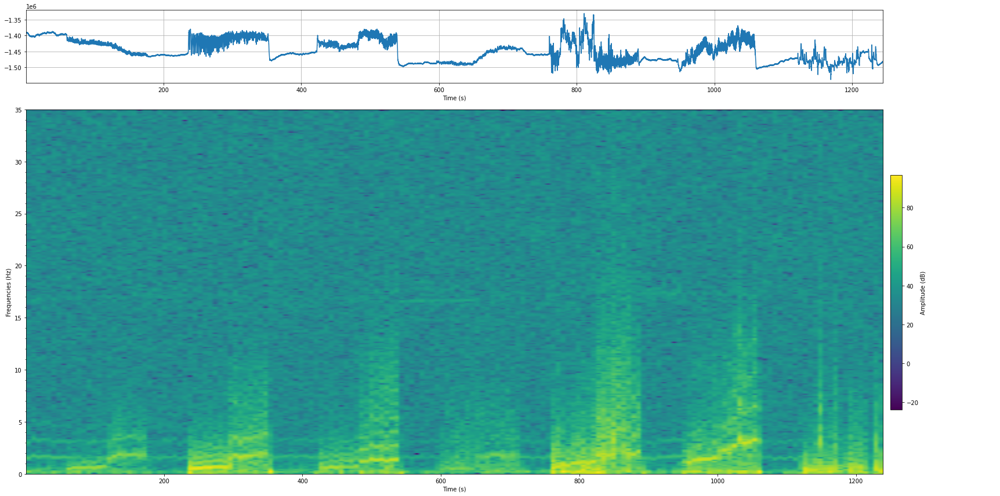

In [ ]:
from matplotlib.ticker import AutoMinorLocator
import matplotlib.pyplot as plt
from scipy.fftpack import fft,fftfreq
# plot it
plt.figure(figsize=(24,3))
f, ax = plt.subplots(2, 2, gridspec_kw={'height_ratios': [1, 5], 'width_ratios': [8, 1]}, figsize=(24,12))

ax[0][1].axis('off')
ml = AutoMinorLocator(5)
ax[0][0].plot(df1['id'], df1['525nm'].values)
ax[0][0].set_xlabel('Time (s)')
ax[0][0].yaxis.set_minor_locator(ml)
#ax[0][0].xaxis.set_minor_locator(ml)
ax[0][0].grid(which='both')
ax[0][0].margins(x=0)

#plt.grid(True)
spec, freqs, t, im = ax[1][0].specgram(df1['525nm'].values, Fs=70, NFFT = 560, noverlap=50, detrend='mean', mode='psd') #cmap="rainbow"
ax[1][0].yaxis.set_minor_locator(ml)
ax[1][0].set_xlabel('Time (s)')
ax[1][0].set_ylabel('Frequencies (Hz)')

ax[1][1].axis('off')
cbar = plt.colorbar(im, ax=[ax[1][1]], location='right')
cbar.set_label('Amplitude (dB)')

f.tight_layout()

In [ ]:
from matplotlib.ticker import AutoMinorLocator
# plot it
plt.figure(figsize=(24,3))
f, ax = plt.subplots(2, 2, gridspec_kw={'height_ratios': [1, 5], 'width_ratios': [8, 1]}, figsize=(24,12))

ax[0][1].axis('off')
ml = AutoMinorLocator(5)
ax[0][0].plot(df['id'],df['Ch : LED 2'].values)
ax[0][0].set_xlabel('Time (s)')
ax[0][0].yaxis.set_minor_locator(ml)
#ax[0][0].xaxis.set_minor_locator(ml)
ax[0][0].grid(which='both')
ax[0][0].margins(x=0)

nfft = 2000
#plt.grid(True)
spec, freqs, t, im = ax[1][0].specgram(df['Ch : LED 2'].values, Fs=250, NFFT = nfft, noverlap=200, detrend='mean', mode='psd') #cmap="rainbow"
ax[1][0].yaxis.set_minor_locator(ml)
ax[1][0].set_xlabel('Time (s)')
ax[1][0].set_ylabel('Frequencies (Hz)')

ax[1][1].axis('off')
cbar = plt.colorbar(im, ax=[ax[1][1]], location='right')
cbar.set_label('Amplitude (dB)')

f.tight_layout()

In [ ]:
### Using Plotly
from matplotlib.ticker import AutoMinorLocator
from plotly.subplots import make_subplots
import plotly.graph_objs as go
from scipy import signal
# Create figure with secondary y-axis

fig = go.Figure()
nfft = 2000
#plt.grid(True)
#spec, freqs, t, im = ax[1][0].specgram(df['Ch : LED 2'].values, Fs=250, NFFT = nfft, noverlap=200, detrend='mean', mode='psd') #cmap="rainbow"
#w = signal.hann(nfft)#blackman(nfft)
w = signal.blackman(nfft)
freqs, t, Pxx = signal.spectrogram(df['Ch : LED 2'].values, fs=250,window = w, nfft=nfft)

fig.add_trace(go.Heatmap(
    x= t,
    y= freqs,
    z= 10*np.log10(Pxx),
    colorscale='Viridis', #Jet rdbu
    ))

fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1800, height=800)
fig.update_layout(title='PPG Spectrum',
                   xaxis_title='Time (s)',
                   yaxis_title='Frequency (hz)',
                  yaxis={
        "tick0": df.index.min(),
        "dtick": 20,
        "ticks":"outside"
        #"autorange": "reversed",
        #"tickformat": "%H:%M",
    },
    )


In [ ]:
### Using Plotly
from matplotlib.ticker import AutoMinorLocator
from plotly.subplots import make_subplots
import plotly.graph_objs as go
from scipy import signal
# Create figure with secondary y-axis
#fig = make_subplots(rows=2, cols=1, insets=[{'l':0.1,'b':0.1, 'h':0.1}])
fig = make_subplots(rows=6, 
                    cols=1, 
                    specs=[
        [{}],
        [{'rowspan':5}],
        [None],
        [None],
        [None],
        [None],],
                    
        shared_xaxes=True,
        #subplot_titles=("test1", "test2"),
        vertical_spacing=0.01)


#minTickLoc = np.linspace(0,120,5)

#fig = go.Figure()
nfft = 1000

w = signal.blackman(nfft)
freqs, t, Pxx = signal.spectrogram(df1['940nm'].values, fs=70,window = w, nfft=nfft)
# trace = [go.Heatmap(
#     x= t,
#     y= freqs,
#     z= 10*np.log10(Pxx),
#     colorscale='Viridis', #Jet rdbu
#     )]
# layout = go.Layout(
#     title = 'Spectrogram with plotly',
#     yaxis = dict(title = 'Frequency'), # x-axis label
#     xaxis = dict(title = 'Time'), # y-axis label
#     )

fig.add_trace(go.Scatter(x=df1['id'], y=df1['940nm'],
                    mode='lines',
                    name='940nm'),
              row = 1, col=1)
fig.update_layout(
    yaxis_title = 'Amplitude'
    )

fig.add_trace(go.Heatmap(
    x= t,
    y= freqs,
    z= 10*np.log10(Pxx),
    colorscale='Viridis', #Jet rdbu
    ), row=2, col=1)

#fig.update_xaxes(title_text="Time (s)", row = 1, col = 1)
fig.update_yaxes(title_text="Frequency (hz)", row = 2, col = 1)
fig.update_xaxes(title_text="Time (s)", row = 2, col = 1)
fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1800, height=800)
fig.update_layout(title_text="PPG Signals")

### Save the figure as a HTML file
# with open('Spectrogram'+'.html', 'a') as f:
#   f.write(fig.to_html(full_html=False, include_plotlyjs='cdn'))

#ScaloGram

In [ ]:
!pip install scaleogram

[Text(0, 0, '0'),
 Text(0, 0, '200'),
 Text(0, 0, '400'),
 Text(0, 0, '600'),
 Text(0, 0, '800'),
 Text(0, 0, '1000'),
 Text(0, 0, '1200')]

<Figure size 1728x216 with 0 Axes>

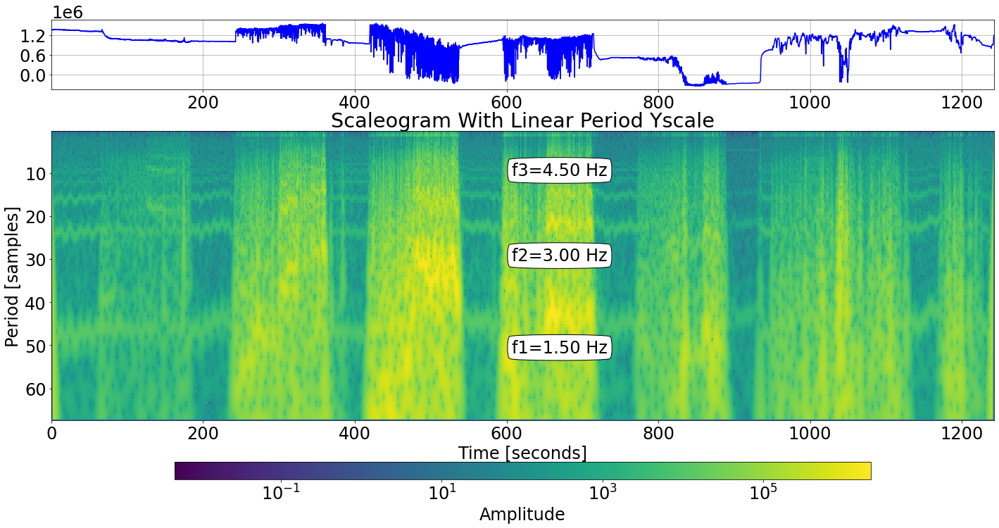

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import scaleogram as scg
# set number of locator
from matplotlib.ticker import MaxNLocator

from matplotlib.ticker import AutoMinorLocator
# plot it
plt.figure(figsize=(24,3))
plt.rcParams['font.size'] = 24
#plt.locator_params(axis='x', nbins=6)
fig, ax = plt.subplots(2, 1, gridspec_kw={'height_ratios': [1, 5]}, figsize=(24,12)) #'width_ratios': [8, 1]

#ax[0][1].axis('off')
#ax[1][1].axis('off')
ml = AutoMinorLocator(5)

wavelet='cmor5-3'  # 
#wavelet= 'shan6-3'
#wavelet = 'fbsp1-1.5-1.0'
#wavelet = 'cgau5'
#n = len(df_rsp1['id'])
Fs = 70
f1 = 1.5; p1 = Fs/f1 
f2 = 3.0; p2 = Fs/f2
f3 = 4.5; p3 = Fs/f3
#fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 12))
fig.subplots_adjust(hspace=0.2)
ax[0].plot(df1['id'],df1['850nm'].values, c='b')
ax[0].margins(x=0)
ax[0].grid(which='both')
ax[0].yaxis.set_major_locator(MaxNLocator(4))
#ax1.plot(time, data, c='b');
#ax1.set_xlim(0, n)
#scales_linear  = np.arange(1, 1000)/10.
scales_log = np.logspace(0, 1.8)
n = len(df1['id'])
t = np.arange(n)
ax[1] = scg.cws(t, df1['850nm'].values, scales=np.arange(1, 200, 2), wavelet=wavelet,coi=True, coikw={'alpha':0.5, 'hatch':'/'},
        ax=ax[1], cmap="viridis", cbar='horizontal', ylabel="Period [samples]", xlabel="Time [seconds]", cscale='log', cbarlabel='Amplitude', #yscale='log',
        #cbarkw={ 'aspect':30, 'pad':0.03, 'fraction':0.05},
        title='Scaleogram With Linear Period Yscale')
txt = ax[1].annotate("f1=%.2f Hz" % f1, xy=(n/2,p1), xytext=(n/2-1000, p1+5), bbox=dict(boxstyle="round4", fc="w"),size=24)
txt = ax[1].annotate("f2=%.2f Hz" % f2, xy=(n/2,p2), xytext=(n/2-1000, p2+7), bbox=dict(boxstyle="round4", fc="w"),size=24)
txt = ax[1].annotate("f3=%.2f Hz" % f3, xy=(n/2,p3), xytext=(n/2-1000, p3-5), bbox=dict(boxstyle="round4", fc="w"),size=24)
#ax[1].xaxis.set_ticks(np.arange(0, np.round(df1['id'].tail(1).item()), 200))
#ax[1].xaxis.set_major_locator(MaxNLocator(7))

ax[1].xaxis.set_ticks(np.arange(0, n, 200*70))

arr = np.arange(0, np.round(df1['id'].tail(1).item()), 200)
labels = [str(int(x)) for x in arr]
ax[1].set_xticklabels(labels)


In [ ]:
np.round(df1['id'].tail(1).item())

1243.0

In [ ]:
arr = np.arange(0, np.round(df1['id'].tail(1).item()), 200)
labels = [str(int(x)) for x in arr]

#### Scalogram for Acc

<Figure size 1728x216 with 0 Axes>

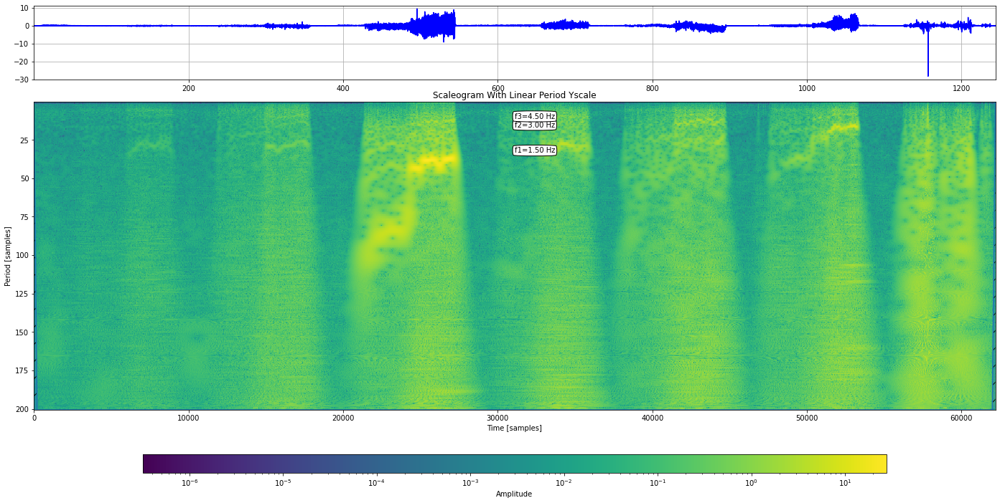

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import scaleogram as scg

from matplotlib.ticker import AutoMinorLocator
# plot it
plt.figure(figsize=(24,3))
fig, ax = plt.subplots(2, 1, gridspec_kw={'height_ratios': [1, 5]}, figsize=(24,12)) #'width_ratios': [8, 1]

#ax[0][1].axis('off')
#ax[1][1].axis('off')
ml = AutoMinorLocator(5)

wavelet='cmor5-3'  # 
#wavelet= 'shan6-3'
#wavelet = 'fbsp1-1.5-1.0'
#wavelet = 'cgau5'
#n = len(df_rsp1['id'])
Fs = 50
f1 = 1.5; p1 = Fs/f1
f2 = 3.0; p2 = Fs/f2
f3 = 4.5; p3 = Fs/f3
#fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 12))
fig.subplots_adjust(hspace=0.1)
ax[0].plot(df3['id'],df3['Acc_Z2'].values, c='b')
ax[0].margins(x=0)
ax[0].grid(which='both')
#ax1.plot(time, data, c='b');
#ax1.set_xlim(0, n)
#scales_linear  = np.arange(1, 1000)/10.
scales_log = np.logspace(0, 1.8)
n = len(df3['id'])
t = np.arange(n)
ax[1] = scg.cws(t, df3['Acc_Z2'].values, scales=np.arange(1, 600, 2), wavelet=wavelet,coi=True, coikw={'alpha':0.5, 'hatch':'/'},
        ax=ax[1], cmap="viridis", cbar='horizontal', ylabel="Period [samples]", xlabel="Time [samples]", cscale='log', cbarlabel='Amplitude', #yscale='log',
        #cbarkw={ 'aspect':30, 'pad':0.03, 'fraction':0.05},
        title='Scaleogram With Linear Period Yscale')
txt = ax[1].annotate("f1=%.2f Hz" % f1, xy=(n/2,p1), xytext=(n/2-10, p1), bbox=dict(boxstyle="round4", fc="w"))
txt = ax[1].annotate("f2=%.2f Hz" % f2, xy=(n/2,p2), xytext=(n/2-10, p2), bbox=dict(boxstyle="round4", fc="w"))
txt = ax[1].annotate("f3=%.2f Hz" % f3, xy=(n/2,p3), xytext=(n/2-10, p3), bbox=dict(boxstyle="round4", fc="w"))

### EMD Analysis

In [ ]:
!pip install EMD-signal

     |████████████████████████████████| 46 kB 3.3 MB/s 
     |████████████████████████████████| 81 kB 8.4 MB/s 
     |████████████████████████████████| 65 kB 3.7 MB/s 


In [ ]:
from PyEMD import EMD

N = 256
s = df1['850nm'][:256].values

emd = EMD()
IMFs = emd.emd(s)


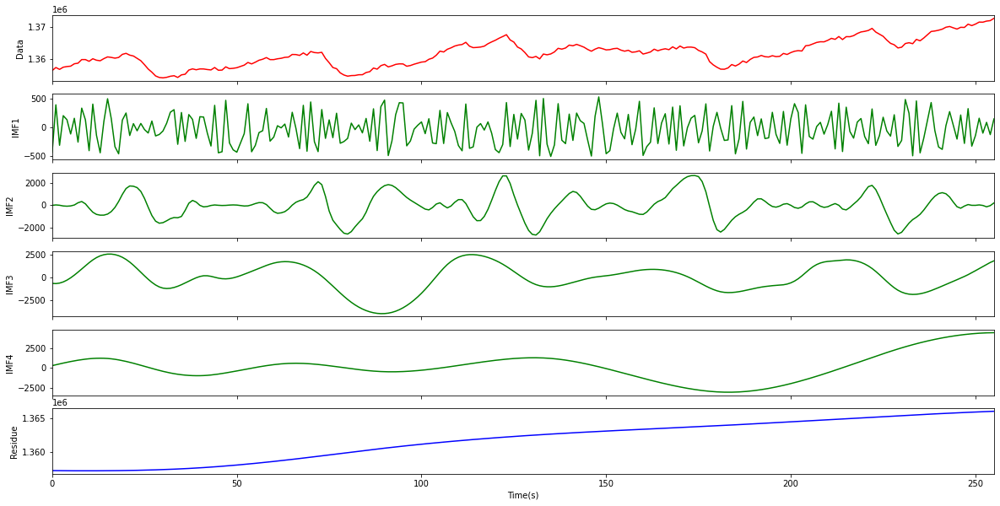

In [ ]:
N = IMFs.shape[0]
fig, axs = plt.subplots(N+1,1,figsize=(20,10))


L1, L2 = 0, len(s)
# range of x after convert to sampling rate at 70
x = [i/70 for i in range(L1,L2)]


n = [i for i in range(0,N+1)]
#labels = ['s','d1','d2','d3','d4','d5','d6','d7', 'a7']
for ax,i in zip(axs,n):
  

  if i==N:
     ax.plot(IMFs[N-1][L1:L2],'b')
     ax.set_xlabel('Time(s)')
     ax.set_ylabel('Residue') 
     #ax.xaxis.set_ticklabels(xlabel)
  elif i==0:
    ax.plot(s[L1:L2],'r')
    ax.set_ylabel('Data')
    #ax.xaxis.set_ticklabels([])
  else:
    ax.plot(IMFs[i-1][L1:L2],'g')
    ax.set_ylabel('IMF'+str(i))
  ax.label_outer()
  ax.margins(x=0)
  #ax.yaxis.tick_right()
  #ax.yaxis.Exponent = 5


Text(0, 0.5, 'y = IMF2 + IMF3')

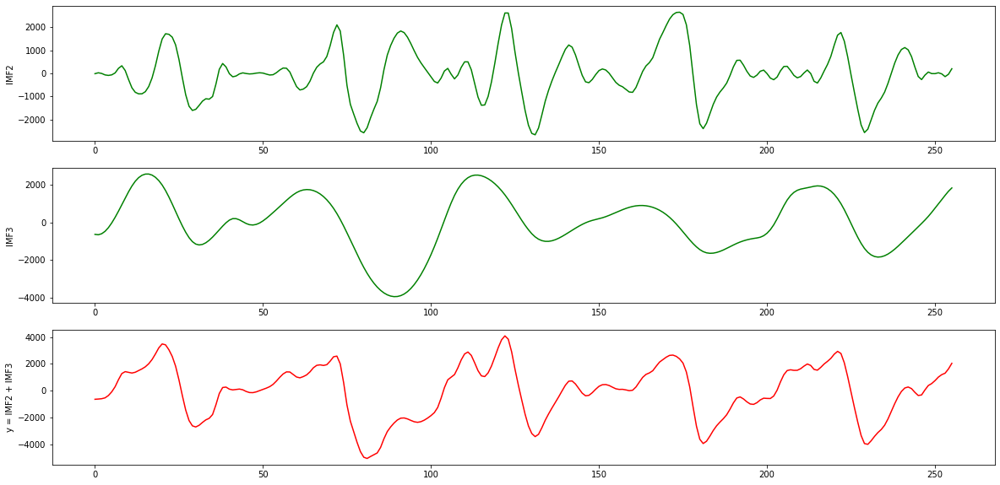

In [ ]:
fig, ax = plt.subplots(3,1, figsize=((20,10)))

y = IMFs[3] + IMFs[2]
ax[0].plot(IMFs[2][L1:L2],'g')
ax[0].set_ylabel('IMF3')

ax[1].plot(IMFs[3][L1:L2],'g')
ax[1].set_ylabel('IMF4')

ax[2].plot(y[L1:L2],'r')
ax[2].set_ylabel('y = IMF3 + IMF4')


### Filtering, Using BioSppy Package

In [ ]:
!pip install biosppy

     |████████████████████████████████| 85 kB 2.3 MB/s 
  Created wheel for biosppy: filename=biosppy-0.7.3-py2.py3-none-any.whl size=95430 sha256=a868d7e07290433a4a58b33c80f12b9f370ecbb90e084dfb13066fe921e54f2e
  Stored in directory: /root/.cache/pip/wheels/2f/4f/8f/28b2adc462d7e37245507324f4817ce1c64ef2464f099f4f0b
Successfully built biosppy


In [ ]:
from biosppy.signals import tools as tools

def filter_ppg(signal, fs, flow=0.5,fhigh=8):
  signal = np.array(signal)
  fs = float(fs)
  filtered, _, _ = tools.filter_signal( signal = signal,
                                      ftype='butter',
                                      band='bandpass',
                                      order = 4,
                                      frequency = [flow, fhigh],
                                      sampling_rate = fs)
  return filtered

In [ ]:
s = df1['525nm'].values

s_fil = filter_ppg(s, fs=70, flow=1, fhigh=5)

<Figure size 1728x216 with 0 Axes>

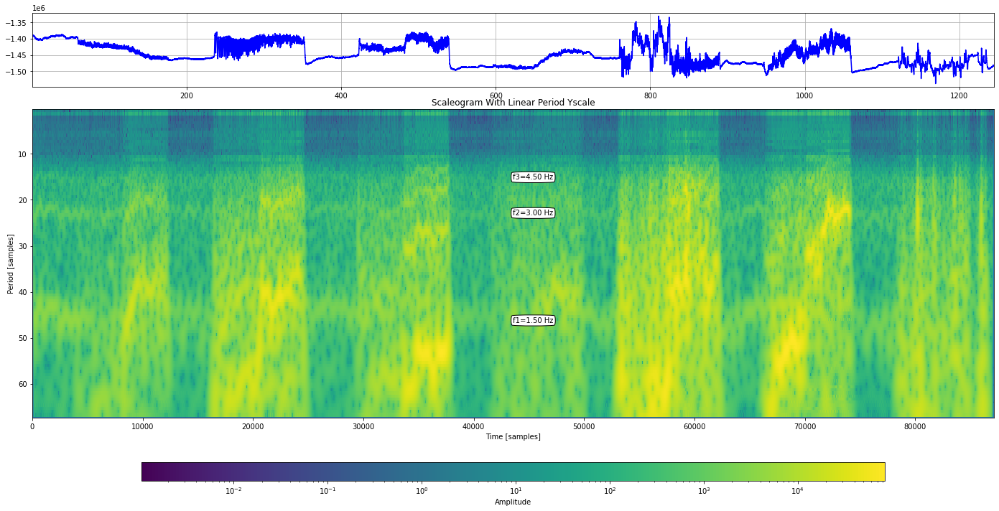

In [ ]:
from matplotlib.ticker import AutoMinorLocator
# plot it
plt.figure(figsize=(24,3))
fig, ax = plt.subplots(2, 1, gridspec_kw={'height_ratios': [1, 5]}, figsize=(24,12)) #'width_ratios': [8, 1]

#ax[0][1].axis('off')
#ax[1][1].axis('off')
ml = AutoMinorLocator(5)

wavelet='cmor5-3'  # 
#wavelet= 'shan6-3'
#wavelet = 'fbsp1-1.5-1.0'
#wavelet = 'cgau5'
#n = len(df_rsp1['id'])
Fs = 70
f1 = 1.5; p1 = Fs/f1
f2 = 3.0; p2 = Fs/f2
f3 = 4.5; p3 = Fs/f3
#fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 12))
fig.subplots_adjust(hspace=0.1)
ax[0].plot(df1['id'],s, c='b') #s_fil
ax[0].margins(x=0)
ax[0].grid(which='both')
#ax1.plot(time, data, c='b');
#ax1.set_xlim(0, n)
#scales_linear  = np.arange(1, 1000)/10.
scales_log = np.logspace(0, 1.8)
n = len(df1['id'])
t = np.arange(n)
ax[1] = scg.cws(t, s_fil, scales=np.arange(1, 200, 2), wavelet=wavelet,coi=True, coikw={'alpha':0.5, 'hatch':'/'},
        ax=ax[1], cmap="viridis", cbar='horizontal', ylabel="Period [samples]", xlabel="Time [samples]", cscale='log', cbarlabel='Amplitude', #yscale='log',
        #cbarkw={ 'aspect':30, 'pad':0.03, 'fraction':0.05},
        title='Scaleogram With Linear Period Yscale')
txt = ax[1].annotate("f1=%.2f Hz" % f1, xy=(n/2,p1), xytext=(n/2-10, p1), bbox=dict(boxstyle="round4", fc="w"))
txt = ax[1].annotate("f2=%.2f Hz" % f2, xy=(n/2,p2), xytext=(n/2-10, p2), bbox=dict(boxstyle="round4", fc="w"))
txt = ax[1].annotate("f3=%.2f Hz" % f3, xy=(n/2,p3), xytext=(n/2-10, p3), bbox=dict(boxstyle="round4", fc="w"))

In [ ]:
import plotly.graph_objects as go

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=df1['id'], y=s,
                    mode='lines',
                    name='850nm raw'))
fig.add_trace(go.Scatter(x=df1['id'], y=s_fil,
                    mode='lines',
                    name='850 nm filtered'))


fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='PPG data',
                   xaxis_title='Samples',
                   yaxis_title='Amplitude')
#fig.add_trace(go.Scatter(x=random_x, y=random_y1, mode='lines+markers', name='lines+markers'))
#fig.add_trace(go.Scatter(x=random_x, y=random_y2, mode='markers', name='markers'))
fig.show()